# <center> Comparación de los modelos

Se realizan test estadísticos sobre los resultados en train de los modelos y posteriormente se aplica el algoritmo de decisión multicriterio

In [1]:
import pandas as pd
from pandas import read_csv
import seaborn as sns

from sklearn.model_selection import TimeSeriesSplit
from sklearn.model_selection import train_test_split

import joblib as joblib

import matplotlib.pyplot as plt

import scikit_posthocs as scp
import scipy.stats as stats
import operator
import numpy as np
import statsmodels as st
import pingouin as pg

import math
import sklearn.metrics as sm

import plotly.express as px
from flask import Flask
import flask
from plotly.subplots import make_subplots
import plotly.graph_objects as go

C:\Users\Carmen\anaconda3\lib\site-packages\outdated\utils.py:14: OutdatedPackageWarning: The package outdated is out of date. Your version is 0.2.0, the latest is 0.2.1.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


# Visualización de los errores

En esta primera sección visualizamos de forma gráfica y numérica los errores cometidos en las predicciones tanto en training (en cada uno de los pliegues) como en test en la predicción t. De esta forma podremos apoyarnos en los resultados para detectar modelos que pueden estar haciendo overfitting

## RMSE

### Lectura de los datos y descripción estadística

In [2]:
RMSE_train = read_csv('../Datos_preprocesados/RMSE_errores_train.csv', encoding ='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
RMSE_train.drop(columns = "Pliegues", inplace = True)
RMSE_train

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
0,0.010250,0.012253,0.040040,0.021895,0.010777,0.012175,0.015468,0.017608,0.009779,0.011421,0.009565,0.011302
1,0.003465,0.005035,0.006011,0.008859,0.005831,0.004163,0.006113,0.004916,0.003236,0.005702,0.005437,0.004665
2,0.002359,0.002950,0.002599,0.004666,0.002282,0.002253,0.007964,0.006088,0.002058,0.001663,0.002220,0.002200
3,0.005817,0.005213,0.008027,0.008158,0.006893,0.007117,0.012659,0.018517,0.005418,0.005386,0.006962,0.007347
4,0.019228,0.018612,0.015113,0.017661,0.014720,0.014294,0.018877,0.022049,0.018109,0.019953,0.015303,0.015526
5,0.097717,0.099564,0.030118,0.027917,0.031447,0.029454,0.031626,0.026445,0.094637,0.099538,0.031492,0.028937
6,0.054043,0.054168,0.047621,0.046455,0.048174,0.044944,0.050317,0.046399,0.049422,0.054665,0.048253,0.045141
7,0.117732,0.113723,0.064359,0.061369,0.063967,0.061773,0.066249,0.059950,0.118328,0.118405,0.064465,0.062454
8,0.124888,0.141807,0.085793,0.091884,0.085716,0.091056,0.089009,0.093796,0.121939,0.142605,0.085260,0.091053
9,0.060135,0.064386,0.029916,0.038327,0.029938,0.036199,0.029868,0.036866,0.048429,0.046525,0.029645,0.035670


In [3]:
RMSE_train.describe()

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,0.049563,0.051771,0.032960,0.032719,0.029975,0.030343,0.032815,0.033264,0.047135,0.050586,0.029860,0.030430
std,0.048881,0.051414,0.027178,0.027624,0.028047,0.028913,0.027536,0.027363,0.048149,0.052089,0.028119,0.028922
min,0.002359,0.002950,0.002599,0.004666,0.002282,0.002253,0.006113,0.004916,0.002058,0.001663,0.002220,0.002200
25%,0.006925,0.006973,0.009799,0.011060,0.007864,0.008381,0.013362,0.017836,0.006509,0.007132,0.007613,0.008336
50%,0.036635,0.036390,0.030017,0.024906,0.022329,0.021874,0.024372,0.024247,0.033269,0.033239,0.022474,0.022231
75%,0.088322,0.090770,0.045726,0.044423,0.043993,0.042758,0.045644,0.044016,0.083333,0.088320,0.044063,0.042774
max,0.124888,0.141807,0.085793,0.091884,0.085716,0.091056,0.089009,0.093796,0.121939,0.142605,0.085260,0.091053


In [4]:
fig = px.box(RMSE_train, y = RMSE_train.columns, width = 700, height = 400)
fig.show()

In [5]:
print('Media \n',RMSE_train.mean(),'\n \n Desviacion tipica \n',RMSE_train.std())

Media 
 RF_lag3       0.049563
RF_lag5       0.051771
LR_lag3       0.032960
LR_lag5       0.032719
Lasso_lag3    0.029975
Lasso_lag5    0.030343
SVR_lag3      0.032815
SVR_lag5      0.033264
GBR_lag3      0.047135
GBR_lag5      0.050586
EN_lag3       0.029860
EN_lag5       0.030430
dtype: float64 
 
 Desviacion tipica 
 RF_lag3       0.048881
RF_lag5       0.051414
LR_lag3       0.027178
LR_lag5       0.027624
Lasso_lag3    0.028047
Lasso_lag5    0.028913
SVR_lag3      0.027536
SVR_lag5      0.027363
GBR_lag3      0.048149
GBR_lag5      0.052089
EN_lag3       0.028119
EN_lag5       0.028922
dtype: float64


## MAE

### Lectura de los datos y descripción estadística

In [6]:
MAE_train = read_csv('../Datos_preprocesados/MAE_errores_train.csv', encoding ='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
MAE_train.drop(columns = "Pliegues", inplace = True)
MAE_train

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
0,0.008462,0.011392,0.032479,0.014992,0.007227,0.007082,0.012623,0.017494,0.007774,0.009879,0.006476,0.005981
1,0.003400,0.005021,0.004186,0.003734,0.004024,0.002734,0.005366,0.003984,0.003021,0.005115,0.003658,0.003443
2,0.001714,0.002173,0.001866,0.003266,0.001329,0.001685,0.005990,0.004277,0.001440,0.001243,0.001306,0.001632
3,0.002247,0.002934,0.003994,0.002763,0.002256,0.002159,0.007597,0.010134,0.001828,0.001652,0.001959,0.002001
4,0.012167,0.013229,0.011721,0.007150,0.011192,0.012083,0.014557,0.018390,0.012484,0.013561,0.012501,0.012333
5,0.084448,0.087158,0.016943,0.016096,0.017917,0.016959,0.021310,0.012787,0.082231,0.087985,0.020494,0.016918
6,0.033824,0.033456,0.026278,0.026127,0.025823,0.027261,0.034723,0.028557,0.022534,0.032382,0.026455,0.025546
7,0.065309,0.056947,0.036142,0.032730,0.035894,0.033170,0.040139,0.031767,0.074404,0.061051,0.037323,0.032217
8,0.098532,0.118379,0.052798,0.042889,0.055291,0.043395,0.059637,0.043899,0.099885,0.115925,0.054401,0.042336
9,0.043867,0.055397,0.020134,0.024806,0.020085,0.023185,0.018272,0.020647,0.030652,0.040988,0.019380,0.022019


In [7]:
MAE_train.describe()

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,0.035397,0.038609,0.020654,0.017455,0.018104,0.016971,0.022021,0.019194,0.033625,0.036978,0.018395,0.016443
std,0.036337,0.040109,0.016466,0.013860,0.017191,0.014463,0.017656,0.012644,0.037485,0.039825,0.017260,0.013971
min,0.001714,0.002173,0.001866,0.002763,0.001329,0.001685,0.005366,0.003984,0.001440,0.001243,0.001306,0.001632
25%,0.004666,0.006614,0.006070,0.004588,0.004825,0.003821,0.008853,0.010797,0.004210,0.006306,0.004363,0.004077
50%,0.022996,0.023343,0.018539,0.015544,0.014555,0.014521,0.016415,0.017942,0.017509,0.022971,0.015940,0.014626
75%,0.059948,0.056559,0.030929,0.025797,0.024388,0.026242,0.031370,0.026579,0.063466,0.056035,0.024965,0.024665
max,0.098532,0.118379,0.052798,0.042889,0.055291,0.043395,0.059637,0.043899,0.099885,0.115925,0.054401,0.042336


In [8]:
fig = px.box(MAE_train, y = MAE_train.columns, width = 700, height = 400)
fig.show()

In [9]:
print('Media \n',MAE_train.mean(),'\n \n Desviacion tipica \n',MAE_train.std())

Media 
 RF_lag3       0.035397
RF_lag5       0.038609
LR_lag3       0.020654
LR_lag5       0.017455
Lasso_lag3    0.018104
Lasso_lag5    0.016971
SVR_lag3      0.022021
SVR_lag5      0.019194
GBR_lag3      0.033625
GBR_lag5      0.036978
EN_lag3       0.018395
EN_lag5       0.016443
dtype: float64 
 
 Desviacion tipica 
 RF_lag3       0.036337
RF_lag5       0.040109
LR_lag3       0.016466
LR_lag5       0.013860
Lasso_lag3    0.017191
Lasso_lag5    0.014463
SVR_lag3      0.017656
SVR_lag5      0.012644
GBR_lag3      0.037485
GBR_lag5      0.039825
EN_lag3       0.017260
EN_lag5       0.013971
dtype: float64


## CC

### Lectura de los datos y descripción estadística

In [10]:
CC_train = read_csv('../Datos_preprocesados/CC_train.csv', encoding ='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
CC_train.drop(columns = "Pliegues", inplace = True)
CC_train

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
0,0.660,0.851,0.396,0.465,0.431,0.433,0.485,0.465,0.592,0.875,0.458,0.450
1,0.725,0.647,0.065,-0.042,0.160,0.047,0.245,-0.009,0.269,0.734,0.202,0.109
2,0.866,0.907,0.467,0.556,0.486,0.571,0.491,0.553,0.646,0.895,0.497,0.571
3,0.926,0.934,0.337,0.433,0.320,0.445,0.336,0.535,0.871,0.942,0.315,0.442
4,0.863,0.889,0.568,0.601,0.561,0.602,0.689,0.748,0.786,0.981,0.571,0.598
5,0.928,0.932,0.793,0.803,0.796,0.803,0.824,0.826,0.938,0.985,0.796,0.802
6,0.837,0.910,0.517,0.583,0.508,0.600,0.477,0.690,0.909,0.976,0.501,0.598
7,0.943,0.944,0.888,0.913,0.887,0.910,0.860,0.873,0.966,0.981,0.884,0.907
8,0.933,0.948,0.864,0.885,0.862,0.879,0.817,0.811,0.989,0.981,0.861,0.879
9,0.804,0.782,0.620,0.586,0.609,0.591,0.621,0.638,0.844,0.968,0.608,0.587


In [11]:
CC_train.describe()

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
count,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000
mean,0.848500,0.874400,0.551500,0.578300,0.562000,0.588100,0.584500,0.613000,0.781000,0.931800,0.569300,0.594300
std,0.095342,0.094558,0.255903,0.274144,0.235375,0.252187,0.212598,0.257212,0.222787,0.079698,0.225801,0.236204
min,0.660000,0.647000,0.065000,-0.042000,0.160000,0.047000,0.245000,-0.009000,0.269000,0.734000,0.202000,0.109000
25%,0.812250,0.860500,0.413750,0.487750,0.444750,0.476500,0.479000,0.539500,0.681000,0.906750,0.467750,0.480250
50%,0.864500,0.908500,0.542500,0.584500,0.534500,0.595500,0.556000,0.664000,0.857500,0.972000,0.536000,0.592500
75%,0.927500,0.933500,0.749750,0.752500,0.749250,0.752750,0.785000,0.795250,0.930750,0.981000,0.749000,0.751000
max,0.943000,0.948000,0.888000,0.913000,0.887000,0.910000,0.860000,0.873000,0.989000,0.985000,0.884000,0.907000


In [12]:
CC_train.mean()

RF_lag3       0.8485
RF_lag5       0.8744
LR_lag3       0.5515
LR_lag5       0.5783
Lasso_lag3    0.5620
Lasso_lag5    0.5881
SVR_lag3      0.5845
SVR_lag5      0.6130
GBR_lag3      0.7810
GBR_lag5      0.9318
EN_lag3       0.5693
EN_lag5       0.5943
dtype: float64

In [13]:
fig = px.box(CC_train, y = CC_train.columns, width = 700, height = 400)
fig.show()

In [14]:
print('Media \n',CC_train.mean(),'\n \n Desviacion tipica \n',CC_train.std())

Media 
 RF_lag3       0.8485
RF_lag5       0.8744
LR_lag3       0.5515
LR_lag5       0.5783
Lasso_lag3    0.5620
Lasso_lag5    0.5881
SVR_lag3      0.5845
SVR_lag5      0.6130
GBR_lag3      0.7810
GBR_lag5      0.9318
EN_lag3       0.5693
EN_lag5       0.5943
dtype: float64 
 
 Desviacion tipica 
 RF_lag3       0.095342
RF_lag5       0.094558
LR_lag3       0.255903
LR_lag5       0.274144
Lasso_lag3    0.235375
Lasso_lag5    0.252187
SVR_lag3      0.212598
SVR_lag5      0.257212
GBR_lag3      0.222787
GBR_lag5      0.079698
EN_lag3       0.225801
EN_lag5       0.236204
dtype: float64


## Gráficas Train VS Test + Errores

Como hemos comentado, nos apoyaremos en las gráficas y en aquellos modelos para los que haya una diferencia de 0.20 o más entre las predicciones de train y test, que consideraremos que están haciendo overfitting

In [15]:
df_predictor_lag3_escalado = read_csv('../Datos_preprocesados/predictor_lag3_escalado.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_predictor_lag3_escalado = df_predictor_lag3_escalado.set_index('Fecha')

df_predictor_lag5_escalado = read_csv('../Datos_preprocesados/predictor_lag5_escalado.csv', encoding='latin-1', sep = ',', na_values = ['NaN', 'NaT'])
df_predictor_lag5_escalado = df_predictor_lag5_escalado.set_index('Fecha')

X_train_3, X_test_3, y_train_3, y_test_3 = train_test_split(df_predictor_lag3_escalado.drop(['Incidentes'], axis=1),
                                        df_predictor_lag3_escalado['Incidentes'], train_size = 0.8, test_size = 0.2, 
                                        random_state = 42, shuffle = False)

X_train_5, X_test_5, y_train_5, y_test_5 = train_test_split(df_predictor_lag5_escalado.drop(['Incidentes'], axis=1),
                                        df_predictor_lag5_escalado['Incidentes'], train_size = 0.8, test_size = 0.2, 
                                        random_state = 42, shuffle = False)

In [16]:
modelos = []

modelos.append(joblib.load('rf_lag3_escalado.pkl'))
modelos.append(joblib.load('rf_lag5_escalado.pkl'))

modelos.append(joblib.load('regresion_lineal_lag3_escalado.pkl'))
modelos.append(joblib.load('regresion_lineal_lag5_escalado.pkl'))

modelos.append(joblib.load('lasso_lag3_escalado.pkl'))
modelos.append(joblib.load('lasso_lag5_escalado.pkl'))

modelos.append(joblib.load('svr_lag3_escalado.pkl'))
modelos.append(joblib.load('svr_lag5_escalado.pkl'))

modelos.append(joblib.load('gbr_lag3_escalado.pkl'))
modelos.append(joblib.load('gbr_lag5_escalado.pkl'))

modelos.append(joblib.load('en_lag3_escalado.pkl'))
modelos.append(joblib.load('en_lag5_escalado.pkl'))

In [17]:
nombres = ['RF Lag3', 'RF Lag5', 'LR Lag3', 'LR Lag5', 'Lasso Lag3', 'Lasso Lag5', 'SVR Lag3', 'SVR Lag5', 'GBR Lag3', 'GBR Lag5', 'EN Lag3', 'EN Lag5']

In [18]:
def pred_train_test(modelo, lag):
    
    if lag == 3:
        X_train = X_train_3
        y_train = y_train_3
        X_test = X_test_3
        y_test = y_test_3
    if lag == 5:
        X_train = X_train_5
        y_train = y_train_5
        X_test = X_test_5
        y_test = y_test_5
        
    fig = make_subplots(rows=1, cols=2)
    
    # Predicción en train
    y_pred_train_modelo = modelo.predict(X_train)
    # Predicción en test
    y_pred_test_modelo = modelo.predict(X_test)
    
    fig.add_trace(go.Scatter(x = y_train.index, y = y_pred_train_modelo, mode = 'lines', name = 'Train Real'), row = 1, col = 1)
    fig.add_trace(go.Scatter(x = y_train.index, y = y_train, mode = 'lines', name = 'Pred Train'), row = 1, col = 1)
    
    fig.add_trace(go.Scatter(x = y_test.index, y = y_pred_test_modelo, mode = 'lines', name = 'Test Real'), row = 1, col = 2)
    fig.add_trace(go.Scatter(x = y_test.index, y = y_test, mode = 'lines', name = 'Pred test'), row = 1, col = 2)
    
    fig.update_layout(showlegend = True, title_text = 'Predicciones Train VS Test ' + str(nombres[i]))
    
    flask.Markup(fig)
    
    fig.show("notebook")
    
    mae_train = sm.mean_absolute_error(y_train, y_pred_train_modelo)
    mae_test = sm.mean_absolute_error(y_test, y_pred_test_modelo)
    
    rmse_train = math.sqrt(sm.mean_squared_error(y_train, y_pred_train_modelo))
    rmse_test = math.sqrt(sm.mean_squared_error(y_test, y_pred_test_modelo))
    
    return mae_train, mae_test, rmse_train, rmse_test

In [19]:
maes_train = []
maes_test = []
rmses_train = []
rmses_test = []

for i in range(0, len(modelos)):
    nombre = nombres[i]
    # Si es numero par
    if i % 2 == 0:
        lag = 3
    else:
        lag = 5
    mae_train, mae_test, rmse_train, rmse_test = pred_train_test(modelos[i], lag)
    maes_train.append(mae_train)
    maes_test.append(mae_test)
    rmses_train.append(rmse_train)
    rmses_test.append(rmse_test)

A simple vista, parece que hay dos modelos que están sobre entrenando, en ambos casos de lag. Estos son Random Forest y Gradient Boosting Regressor (GBR). Veamos numéricamente la diferencia entre los errores. Aquellos cuya diferencia sea de un valor >= 0.2 consideraremos que están sobre entrenando

In [20]:
maes_train = pd.Series(maes_train, index = nombres)
maes_test = pd.Series(maes_test, index = nombres)
rmses_train = pd.Series(rmses_train, index = nombres)
rmses_test = pd.Series(rmses_test, index = nombres)

RMSE_dif = round(rmses_test - rmses_train,2)
MAE_dif = round(maes_test - maes_train,2)

print('Diferencia MAE \n',MAE_dif)
print('Diferencia RMSE \n',RMSE_dif)

Diferencia MAE 
 RF Lag3       0.13
RF Lag5       0.13
LR Lag3       0.07
LR Lag5       0.06
Lasso Lag3    0.07
Lasso Lag5    0.06
SVR Lag3      0.07
SVR Lag5      0.06
GBR Lag3      0.12
GBR Lag5      0.13
EN Lag3       0.07
EN Lag5       0.06
dtype: float64
Diferencia RMSE 
 RF Lag3       0.20
RF Lag5       0.21
LR Lag3       0.10
LR Lag5       0.10
Lasso Lag3    0.10
Lasso Lag5    0.10
SVR Lag3      0.10
SVR Lag5      0.09
GBR Lag3      0.20
GBR Lag5      0.20
EN Lag3       0.10
EN Lag5       0.10
dtype: float64


Aunque podemos ver como en MAE las diferencias no parecen muy significativas, si que lo hacen en el caso del RMSE. Además, como podríamos esperar, estos modelos coinciden con los detectados en las gráficas

## Errores test predicciones

In [21]:
RMSE_test = pd.read_csv('../Datos_preprocesados/RMSE_errores_test.csv')
RMSE_test.drop(columns = 'Predicciones', inplace = True)

MAE_test = pd.read_csv('../Datos_preprocesados/MAE_errores_test.csv')
MAE_test.drop(columns = "Predicciones", inplace = True)

CC_test = pd.read_csv('../Datos_preprocesados/CC_test.csv')
CC_test.drop(columns = "Predicciones", inplace = True)

columnas = CC_train.columns

In [22]:
RMSE_test

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
0,0.22,0.23,0.13,0.13,0.13,0.13,0.13,0.13,0.21,0.21,0.13,0.13
1,0.23,0.23,0.18,0.16,0.16,0.14,0.16,0.14,0.22,0.21,0.16,0.14
2,0.23,0.23,0.21,0.17,0.20,0.16,0.19,0.15,0.22,0.22,0.19,0.15
3,0.23,0.23,0.23,0.19,0.21,0.18,0.20,0.17,0.23,0.22,0.20,0.17
4,0.23,0.23,0.27,0.25,0.23,0.22,0.23,0.21,0.23,0.22,0.22,0.21
5,0.23,0.24,0.30,0.25,0.26,0.23,0.26,0.21,0.23,0.22,0.24,0.22
6,0.24,0.24,0.32,0.30,0.27,0.25,0.27,0.24,0.23,0.22,0.25,0.24
7,0.24,0.24,0.35,0.33,0.28,0.28,0.30,0.27,0.23,0.22,0.26,0.27


In [23]:
MAE_test

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
0,0.14,0.14,0.09,0.08,0.09,0.08,0.09,0.08,0.13,0.13,0.09,0.08
1,0.15,0.15,0.11,0.11,0.10,0.09,0.10,0.09,0.14,0.14,0.10,0.09
2,0.15,0.15,0.14,0.12,0.13,0.11,0.12,0.10,0.14,0.14,0.12,0.10
3,0.15,0.15,0.15,0.13,0.13,0.12,0.13,0.11,0.14,0.14,0.13,0.11
4,0.15,0.15,0.17,0.17,0.15,0.15,0.15,0.14,0.14,0.14,0.14,0.14
5,0.15,0.15,0.19,0.17,0.17,0.16,0.17,0.14,0.15,0.14,0.16,0.15
6,0.15,0.16,0.21,0.21,0.17,0.17,0.18,0.16,0.15,0.14,0.17,0.17
7,0.16,0.16,0.23,0.23,0.19,0.19,0.20,0.19,0.15,0.14,0.17,0.19


In [24]:
CC_test

,RF_lag3,RF_lag5,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,GBR_lag3,GBR_lag5,EN_lag3,EN_lag5
0,0.847,0.859,0.903,0.907,0.903,0.907,0.904,0.905,0.852,0.860,0.904,0.908
1,0.841,0.861,0.841,0.876,0.865,0.894,0.868,0.896,0.832,0.861,0.872,0.901
2,0.838,0.862,0.838,0.870,0.835,0.881,0.842,0.890,0.830,0.859,0.846,0.888
3,0.837,0.861,0.837,0.850,0.835,0.862,0.839,0.875,0.824,0.861,0.844,0.869
4,0.836,0.861,0.836,0.803,0.807,0.829,0.810,0.840,0.824,0.857,0.822,0.840
5,0.835,0.859,0.835,0.813,0.790,0.834,0.788,0.845,0.822,0.855,0.807,0.840
6,0.833,0.857,0.833,0.774,0.785,0.817,0.778,0.823,0.819,0.850,0.802,0.827
7,0.831,0.855,0.831,0.762,0.767,0.799,0.757,0.801,0.815,0.850,0.788,0.809


In [25]:
def calcular_predicciones_lag3(modelo, y_pred, X_test):
    predicciones = []
    X_test_modelo = X_test.copy()
    for i in range(1,8):
        # Modificamos el conjunto de test
        X_test_modelo['Incidentes t-3'] = X_test_modelo['Incidentes t-2']
        X_test_modelo['Incidentes t-2'] = X_test_modelo['Incidentes t-1']
        X_test_modelo['Incidentes t-1'] = y_pred
        # Predecimos
        y_pred = modelo.predict(X_test_modelo)
        # Ajustamos al tamaño
        pred = y_pred[i:]
        predicciones.append(pred)
    return predicciones

In [26]:
def calcular_predicciones_lag5(modelo, y_pred, X_test):
    predicciones = []
    X_test_modelo = X_test.copy()
    for i in range(1,8):
        # Modificamos el conjunto de test
        X_test_modelo['Incidentes t-5'] = X_test_modelo['Incidentes t-4']
        X_test_modelo['Incidentes t-4'] = X_test_modelo['Incidentes t-3']
        X_test_modelo['Incidentes t-3'] = X_test_modelo['Incidentes t-2']
        X_test_modelo['Incidentes t-2'] = X_test_modelo['Incidentes t-1']
        X_test_modelo['Incidentes t-1'] = y_pred
        # Predecimos
        y_pred = modelo.predict(X_test_modelo)
        # Ajustamos al tamaño
        pred = y_pred[i:]
        predicciones.append(pred)
    return predicciones

In [27]:
def pred_test(modelo, lag, nombre):
    
    palette = plt.get_cmap('prism')
    
    if lag == 3:
        X_test = X_test_3
        y_test = y_test_3
    if lag == 5:
        X_test = X_test_5
        y_test = y_test_5
    
    # Predicción en train
    y_pred_modelo = modelo.predict(X_test)
    # Calculamos el error
    # Conjunto real = y_test
    
    if lag == 3:
        predicciones_modelo = calcular_predicciones_lag3(modelo, y_pred_modelo, X_test)
    if lag == 5:
        predicciones_modelo = calcular_predicciones_lag5(modelo, y_pred_modelo, X_test)
        
    plt.style.use('seaborn')
    
    plt.title('Real VS Test - '+nombre, loc = 'center', fontsize = 12, fontweight = 0, color = 'black')
    
    y_test.plot(linewidth = 1.2, alpha = 1, label = 'Incidentes Reales')
    pd.Series(y_pred_modelo).plot(linewidth = 1.2, alpha = 1, label = 'Incidentes t')
    
    for i in range(1,len(predicciones_modelo)+1):
        # Tomo la predicción en t+i
        s = pd.Series(predicciones_modelo[i-1])
        # Para mostrarla, la desplazo i valores a la derecha para colocarla en el dia correspondiente de prediccion
        s = s.shift(+i)
        s.dropna(axis = 0, inplace = True)
        s.plot(linewidth = 1.2, alpha = 1, label = 'Incidentes t+'+str(i))
        
    plt.legend(bbox_to_anchor=(1.3, 1.05))

    plt.xticks(rotation=90)
    plt.show()

In [28]:
nombres = ['LR Lag3', 'LR Lag5', 'Lasso Lag3', 'Lasso Lag5', 'SVR Lag3', 'SVR Lag5', 'EN Lag3', 'EN Lag5']

In [29]:
modelos = []

modelos.append(joblib.load('regresion_lineal_lag3_escalado.pkl'))
modelos.append(joblib.load('regresion_lineal_lag5_escalado.pkl'))

modelos.append(joblib.load('lasso_lag3_escalado.pkl'))
modelos.append(joblib.load('lasso_lag5_escalado.pkl'))

modelos.append(joblib.load('svr_lag3_escalado.pkl'))
modelos.append(joblib.load('svr_lag5_escalado.pkl'))

modelos.append(joblib.load('en_lag3_escalado.pkl'))
modelos.append(joblib.load('en_lag5_escalado.pkl'))

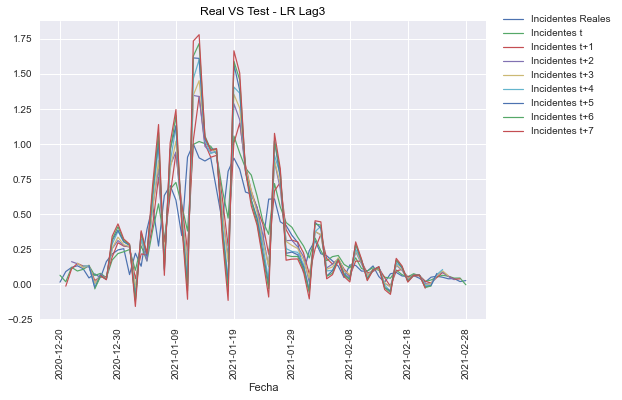

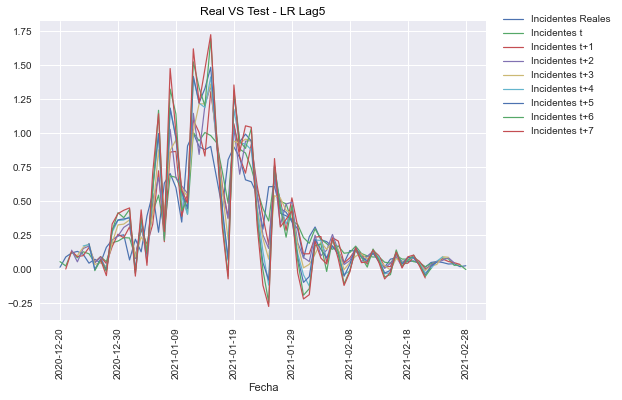

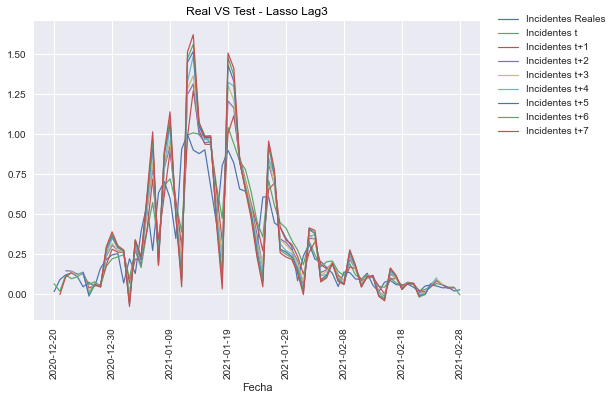

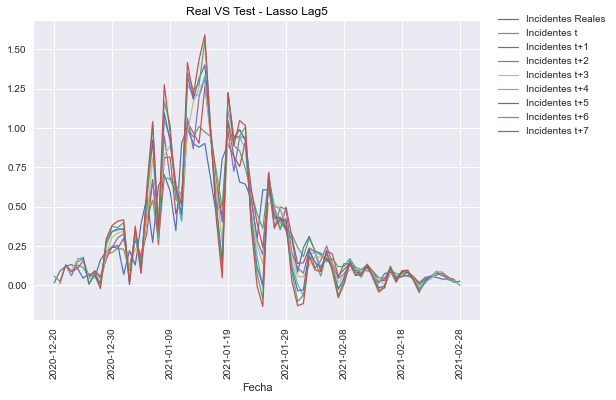

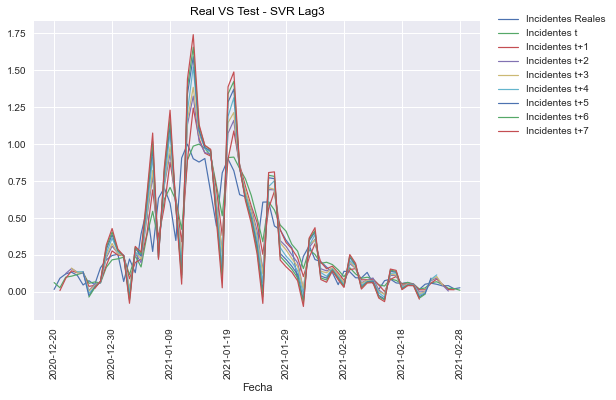

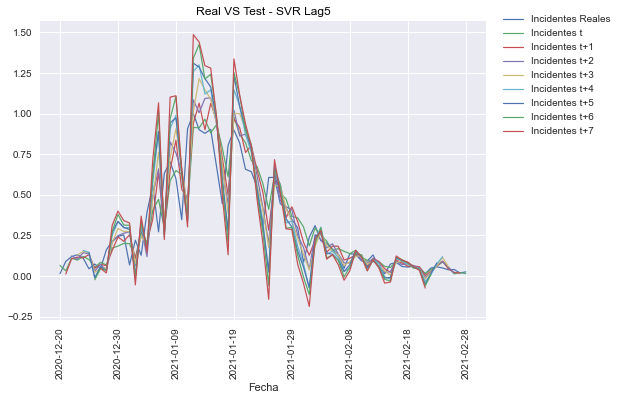

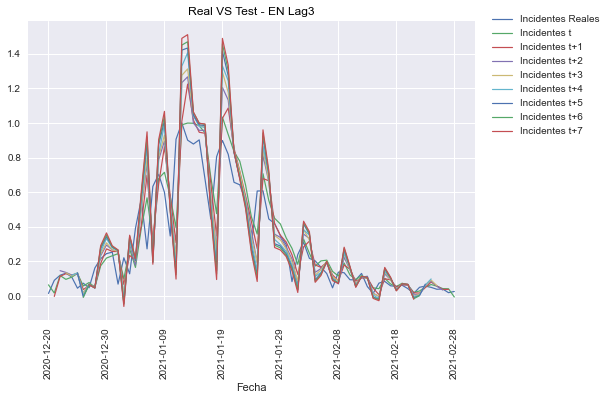

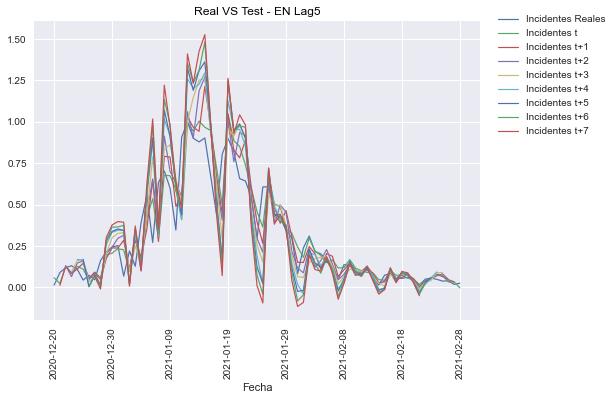

In [30]:
for i in range(0, len(modelos)):
    nombre = nombres[i]
    # Si es numero par
    if i % 2 == 0:
        lag = 3
    else:
        lag = 5
    pred_test(modelos[i],lag, nombre)

# Análisis estadístico

Aplicamos los análisis estadísticos sobre las tres métricas consideradas, para ver si se encuentran diferencias significativas entre los modelos. Descartamos los modelos que sufren overfitting

Detectamos los modelos que han hecho overfitting y los eliminamos

In [31]:
overfitting = []
for i in range(0, len(RMSE_dif)):
    if RMSE_dif[i] >= 0.2 or MAE_dif[i] >= 0.2:
        overfitting.append(i)
        
RMSE_test.drop(columns = RMSE_test.columns[overfitting], inplace=True)
RMSE_train.drop(columns = RMSE_train.columns[overfitting], inplace=True)
MAE_test.drop(columns = MAE_test.columns[overfitting], inplace=True)
MAE_train.drop(columns = MAE_train.columns[overfitting], inplace=True)
CC_test.drop(columns = CC_test.columns[overfitting], inplace=True)
CC_train.drop(columns = CC_train.columns[overfitting], inplace=True)

In [32]:
def pairwise_test(df, parametric = True, method = 'bonferroni', decreasing = True, ties=True):
    # Función que devuelve la matriz de rankings.
    # El dataframe de entrada df debe tener los modelos en las columnas y 
    # las medidas en las filas. 
    # parametric = indica si se aplica un test paramétrico (ttest_rel) o no paramétrico (wilcoxon)
    # decreasing = indica el sentido en el que es mejor la medida utilizada. 
    # ties = indca si se incluyen los empates en el resultado final 
    
    if decreasing:
        relate = operator.lt
    else:
        relate = operator.gt
    
    if parametric:
        test = stats.ttest_rel
    else:
        test = stats.wilcoxon
        
    cols = df.columns
    pvalues = np.array([])
    significant = np.array([])
    ranks = pd.DataFrame({"wins":np.zeros(len(cols)),
                         "ties":np.zeros(len(cols)),
                         "losses":np.zeros(len(cols))})
    ranks.index= cols
    for index1 in range(len(cols)):
        for index2 in range(index1+1,len(cols)):
            T,p = test(df.iloc[:,index1],df.iloc[:,index2])
            pvalues = np.append(pvalues,p)
            
    significant,padjust,a1,a2 = st.stats.multitest.multipletests(pvalues,alpha = 0.05,method = method)

    
    pos = 0;
    for index1 in range(len(cols)):
        for index2 in range(index1+1,len(cols)):
            if not significant[pos]:
                ranks.iloc[index1,1] = ranks.iloc[index1,1]+1
                ranks.iloc[index2,1] = ranks.iloc[index2,1]+1
            else:  
                if relate(df.iloc[:,index1].mean(),df.iloc[:,index2].mean()):
                    ranks.iloc[index1,0] = ranks.iloc[index1,0]+1
                    ranks.iloc[index2,2] = ranks.iloc[index2,2]+1
                else:
                    ranks.iloc[index2,0] = ranks.iloc[index2,0]+1
                    ranks.iloc[index1,2] = ranks.iloc[index1,2]+1
            pos = pos + 1
                
    ranks["diff"] = ranks.wins-ranks.losses
    #ranks = ranks.sort_values(by="diff",ascending = False)
    if  not ties:
        ranks.drop('ties',axis = 'columns', inplace = True)
    return ranks.astype(int)

## RMSE

Aplicamos el test de Shapiro Wilk, la hipóstesis nula es H0: los datos siguen una distribución normal

In [33]:
RMSE_train.apply(stats.shapiro)

,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,EN_lag3,EN_lag5
0,0.926488,0.894526,0.881280,0.884258,0.874022,0.886963,0.880959,0.884850
1,0.414248,0.190580,0.134983,0.145985,0.111330,0.156691,0.133844,0.148267


Como todos los p-valores > 0.05, al 95% de confianza podemos decir que siguen una distribución normal. Lo vemos gráficamente

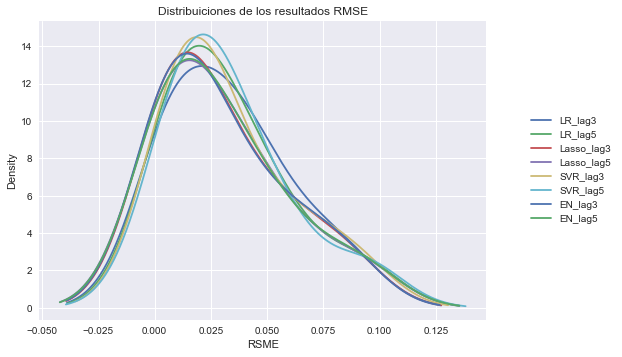

In [34]:
plt.style.use('seaborn-darkgrid')
f = plt.figure()
plt.title("Distribuiciones de los resultados RMSE")
RMSE_train.plot(kind = 'density', ax = f.gca(), alpha = 1, linewidth = 1.8)
f.gca().set_xlabel('RSME')
plt.legend(loc='right', bbox_to_anchor=(1.3,0.5))

In [35]:
test = stats.friedmanchisquare(*[RMSE_train[col] for col in RMSE_train.columns])
test

FriedmanchisquareResult(statistic=16.366666666666674, pvalue=0.021969618535374515)

Podemos afirmar al 95% de confianza que existen diferencias significativas entre los modelos, aplicamos el test de Nemenyi

In [36]:
scp.posthoc_nemenyi_friedman(RMSE_train, melted=False)

,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,EN_lag3,EN_lag5
LR_lag3,1.000000,0.900000,0.900000,0.751638,0.860792,0.900000,0.900000,0.860792
LR_lag5,0.900000,1.000000,0.642482,0.358005,0.900000,0.900000,0.587906,0.477509
Lasso_lag3,0.900000,0.642482,1.000000,0.900000,0.210653,0.860792,0.900000,0.900000
Lasso_lag5,0.751638,0.358005,0.900000,1.000000,0.068652,0.587906,0.900000,0.900000
SVR_lag3,0.860792,0.900000,0.210653,0.068652,1.000000,0.900000,0.172514,0.111334
SVR_lag5,0.900000,0.900000,0.860792,0.587906,0.900000,1.000000,0.806216,0.697062
EN_lag3,0.900000,0.587906,0.900000,0.900000,0.172514,0.806216,1.000000,0.900000
EN_lag5,0.860792,0.477509,0.900000,0.900000,0.111334,0.697062,0.900000,1.000000


La potencia del test de Nemenyi no permite detectar diferencias significativas, como podemos observar. Aplicamos por último el test no paramétrico de Wilcoxon

In [37]:
rsme_ranks = pairwise_test(RMSE_train, parametric=False, decreasing=True, ties= False, method="holm")
rsme_ranks

,wins,losses,diff
LR_lag3,0,0,0
LR_lag5,0,0,0
Lasso_lag3,0,0,0
Lasso_lag5,0,0,0
SVR_lag3,0,0,0
SVR_lag5,0,0,0
EN_lag3,0,0,0
EN_lag5,0,0,0


El test de Wilcoxon tampoco permite detectar las diferencias entre los modelos. Veamos que ocurre con MAE

## MAE

Seguiremos el mismo procedimiento que con RMSE

In [38]:
MAE_train.apply(stats.shapiro)

,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,EN_lag3,EN_lag5
0,0.935417,0.912743,0.886039,0.917546,0.869829,0.946054,0.894715,0.919158
1,0.503236,0.300369,0.152955,0.336945,0.099507,0.622112,0.191507,0.349987


De nuevo detecta que siguen todos una distribución normal

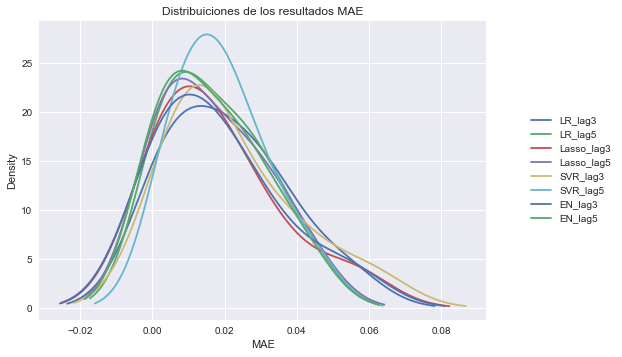

In [39]:
plt.style.use('seaborn-darkgrid')
f = plt.figure()
plt.title("Distribuiciones de los resultados MAE")
MAE_train.plot(kind = 'density', ax = f.gca(), alpha = 1, linewidth = 1.8)
f.gca().set_xlabel('MAE')
plt.legend(loc='right', bbox_to_anchor=(1.3,0.5))

In [40]:
test = stats.friedmanchisquare(*[MAE_train[col] for col in MAE_train.columns])
test

FriedmanchisquareResult(statistic=18.23333333333335, pvalue=0.010960450248375383)

De nuevo, un p-valor por debajo del nivel de significancia permite afirmar al 95% de confianza que existen diferencias significativas entre los modelos. Veamos si las detecta Nemenyi

In [41]:
scp.posthoc_nemenyi_friedman(MAE_train, melted=False)

,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,EN_lag3,EN_lag5
LR_lag3,1.000000,0.900000,0.900000,0.900000,0.806216,0.900000,0.900000,0.254294
LR_lag5,0.900000,1.000000,0.900000,0.900000,0.172514,0.900000,0.900000,0.900000
Lasso_lag3,0.900000,0.900000,1.000000,0.900000,0.210653,0.900000,0.900000,0.860792
Lasso_lag5,0.900000,0.900000,0.900000,1.000000,0.172514,0.900000,0.900000,0.900000
SVR_lag3,0.806216,0.172514,0.210653,0.172514,1.000000,0.860792,0.172514,0.003165
SVR_lag5,0.900000,0.900000,0.900000,0.900000,0.860792,1.000000,0.900000,0.210653
EN_lag3,0.900000,0.900000,0.900000,0.900000,0.172514,0.900000,1.000000,0.900000
EN_lag5,0.254294,0.900000,0.860792,0.900000,0.003165,0.210653,0.900000,1.000000


Según el test de Nemenyi, debería de haber alguna diferencia significativa entre algunos modelos, puesto que existen p-valores por debajo del nivel de significancia. Veamos si las detecta el test de Wilcoxon

In [42]:
mae_ranks = pairwise_test(MAE_train, parametric=False, decreasing=True, ties= False, method="holm")
mae_ranks

,wins,losses,diff
LR_lag3,0,0,0
LR_lag5,0,0,0
Lasso_lag3,0,0,0
Lasso_lag5,0,0,0
SVR_lag3,0,0,0
SVR_lag5,0,0,0
EN_lag3,0,0,0
EN_lag5,0,0,0


De nuevo, la potencia del test paramétrico no detecta diferencias significativas, no pudiendo establecer wins y losses. Seguramente esto se deba a que las diferencias son pequeñas, cerca del límite

## CC

In [43]:
CC_train.apply(stats.shapiro)

,LR_lag3,LR_lag5,Lasso_lag3,Lasso_lag5,SVR_lag3,SVR_lag5,EN_lag3,EN_lag5
0,0.958121,0.887266,0.957226,0.912596,0.934377,0.846537,0.948635,0.923018
1,0.764250,0.157936,0.753839,0.299302,0.492296,0.052824,0.652372,0.382816


De nuevo, los modelos siguen una distribución normal

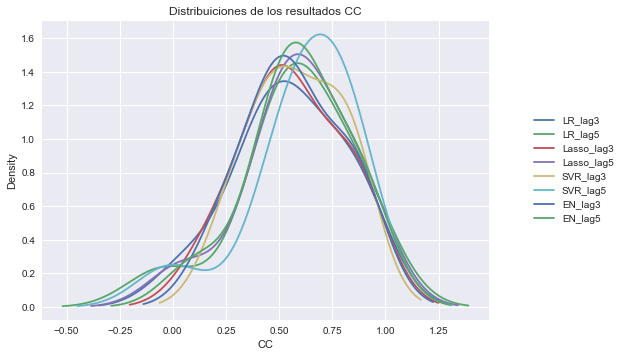

In [44]:
plt.style.use('seaborn-darkgrid')
f = plt.figure()
plt.title("Distribuiciones de los resultados CC")
CC_train.plot(kind = 'density', ax = f.gca(), alpha = 1, linewidth = 1.8)
f.gca().set_xlabel('CC')
plt.legend(loc='right', bbox_to_anchor=(1.3,0.5))

Veamos si el test de Friedman de Chi Square indica que hay diferencias significativas

In [45]:
test = stats.friedmanchisquare(*[CC_train[col] for col in CC_train.columns])
test

FriedmanchisquareResult(statistic=12.65868263473052, pvalue=0.08087428551735754)

El p-valor > 0.05 así que aceptamos H0: no existen diferencias significativas

# Algoritmo de Decisión Multicriterio

Los test estadísticos no son concluyentes, pues aunque si apuntan a que existen algunas diferencias entre ciertos pares de modelos, no son detectables. Por ello, aplicamos el algoritmo de decisión multicriterio sobre los datos de test. 

Transformamos las tablas, creando un dataframe para cada modelo donde se incluyan las tres métricas

In [46]:
# Las tres tablas tienen las mismas columnas
modelos = CC_test.columns
tablas = []

for i in range(0, len(modelos)):
    df = pd.DataFrame()
    df['RMSE'] = RMSE_test[modelos[i]]
    df['MAE'] = MAE_test[modelos[i]]
    # En el caso de CC, cuanto más alto mejor, al contrario que RMSE y MAE
    df['CC'] = round(1 - CC_test[modelos[i]],3)
    # Guardamos en un csv
    df.to_csv(path_or_buf = '../Datos_preprocesados/multicriterio_'+modelos[i]+'.csv')
    # Añadimos a la lista
    tablas.append(df)

Mostramos a continuación las gráficas de los modelos que muestran la evolución de RMSE, MAE y CC a lo largo de las predicciones

In [47]:
i = 0
for t in tablas:
    
    # Creamos df 
    datos = {'RMSE': t['RMSE'].values,
             'MAE': t['MAE'].values,
             'CC': t['CC'].values}

    df = pd.DataFrame(data = datos)

    fig = px.line(df, x = t.index, y = df.columns,
                  title = 'RMSE, MAE, CC para el modelo '+modelos[i], width = 700, height = 400)
    
    #t[['RMSE','MAE','CC']].plot(grid = True,title = modelos[i])
    
    flask.Markup(fig)
    
    fig.show()
    
    i = i+1

Para trabajar con el algoritmo de decisión multicriterio necesitamos normalizar los datos

In [48]:
# Unimos todos los errores
union = pd.concat(tablas)
# Cogemos el minimo
minimo = union.min()
min_rmse = minimo[0]
min_mae = minimo[1]
min_cc = minimo[2]
# Cogemos el maximo
maximo = union.max()
max_rmse = maximo[0]
max_mae = maximo[1]
max_cc = maximo[2]

In [49]:
resultados = []

# Para cada modelo
for t in tablas:
    
    # Normalizamos el dataframe -> obtenemos los errores normalizados para el modelo
    t_norm = pd.DataFrame()
    t_norm['RMSE'] = (t['RMSE'] - min_rmse)/(max_rmse - min_rmse)
    t_norm['MAE'] = (t['MAE'] - min_mae)/(max_mae - min_mae)
    t_norm['CC'] = (t['CC'] - min_cc)/(max_cc - min_cc)

    # Ahora sumamos los errores -> obtenemos sRMSE, sMAE, sCC
    sRMSE = t_norm['RMSE'].sum()
    sMAE = t_norm['MAE'].sum()
    sCC = t_norm['CC'].sum()
    
    # Sumamos las diferencias absolutas error(i+1)-error(i)
    mas1_norm = t_norm.drop([0]).reset_index(drop = True)
    # Los valores obtenidos son mRMSE, mMAE, mCC
    diferencias_absolutas = abs(mas1_norm - t_norm).sum()
    
    # Sumamos el producto de los m y s
    v_modelo = sRMSE*(diferencias_absolutas['RMSE']) + sMAE*(diferencias_absolutas['MAE']) + sCC*(diferencias_absolutas['CC'])

    # Sumamos los tres s -> SIN USAR PENDIENTES
    #v_modelo = sRMSE + sMAE + sCC
    
    # Añadimos a la lista de resultados
    resultados.append(v_modelo)

Mostramos los resultados obtenidos en cada modelo

In [50]:
for i in range(0,len(resultados)):
    print('Resultado modelo '+modelos[i]+' = '+str(resultados[i]))

Resultado modelo LR_lag3 = 9.973081944394607
Resultado modelo LR_lag5 = 11.331561457057548
Resultado modelo Lasso_lag3 = 8.385267771148376
Resultado modelo Lasso_lag5 = 6.0890359983325215
Resultado modelo SVR_lag3 = 9.274246203900406
Resultado modelo SVR_lag5 = 5.142233337678833
Resultado modelo EN_lag3 = 6.148534474568541
Resultado modelo EN_lag5 = 4.982633502976949


Nos quedamos con el mínimo de los valores obtenidos, este será nuestro mejor modelo

In [51]:
mejor_resultado = min(resultados)
mejor_modelo = resultados.index(mejor_resultado)
print('Mejor modelo = '+str(modelos[mejor_modelo]+' -> Resultado = '+str(mejor_resultado)))

Mejor modelo = EN_lag5 -> Resultado = 4.982633502976949
